### Named Entity Recognition for I, B tags with Spacy's en_core_web_sm model to train and predict over biomedical journal corpus

##### Homework 3, Fall, 2021
##### Prof. James H. Martin
###### author: Sushma Akoju


#### Named Entity Recognition over medical journal corpus
Required features:
  - Sentence id
  - Word
  - POS
  - Tag

#### Goal: 
The task in homework suggests to detect “Gene” entities which could appear in patterns such as “BII”, “BIO”, or even regex such as “BI[I]*[O]*”.


#### Reference
[Custom NER task using SPACY:]( https://www.youtube.com/watch?v=DxLcMI-EMYI )

#### Intuition/background for this approach:
##### Given that Data analysis of the data sets surrounding words, tags and their corresponding frequencies from the above sections, I found that it is perhaps better to ignore **O** tag. This could be a hurried approach in Named Entity tagging. The tags that are considered are I, B tags only. Once after prediction of I, B tags is complete, we could assume all of the remaining untagged words are O tags due to high frequency of O tags. Since it is a hurried approach, the predictions are expected to tag only **I** and **B** and rest of the words that were not tagged, they are default tagged as **O** tag. This just to understand the importance of **O** tag in the entire tag sequence.

#### The key takeaway
The O tag is very important in recognizing frequent sequence patterns towards the training the model for NER task for this dataset with IOB tags as the tag sequences.

In [ ]:
#Import all required libraries
import spacy
import random
import time
import numpy as np
from spacy.util import minibatch, compounding
import sys
from spacy import displacy
from itertools import chain
import matplotlib.pyplot as plt 
from matplotlib.ticker import MaxNLocator

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
import os
os.path.exists('/content/drive/MyDrive/Colab Notebooks/entity-extraction/hw3/train.tsv')

True

In [ ]:
file = open("/content/drive/MyDrive/Colab Notebooks/entity-extraction/hw3/train.tsv", 'r',  newline="\n")
counter = 0
for line in file:
  #print(line)
  l = line.strip().split("\t")
  #print(l)
  #if len(l)>1:
    #print(l[0:],l[1].strip(),l[0].strip())
  if len(l)<=1:
    #print("new line")
    counter += 1
print(counter)

6899


We have to convert tsv file to the format accepted by spaCy for training.
One of the format supported by spaCy is:
TRAIN_DATA = [[(Sentence, {entities: [(start, end, label)]], ...]

In [ ]:
def load_data_spacy(file_path):
    ''' Converts data from:
    word \t label \n word \t label \n \n word \t label
    to: sentence, {entities : [(start, end, label), (stard, end, label)]}
    '''
    file = open(file_path, 'r', encoding="utf8", newline="\n")
    training_data, entities, sentence = [], [], []
    unique_labels = []
    current_annotation = None
    start =0
    end = 0 # initialize counter to keep track of start and end characters
    lines = file.readlines()
    for line in lines:
        #print(line)
        line = [l.strip() for l in line.strip().split("\t")[1:]]
        # lines with len > 1 are words
        #print(line)
        if len(line) > 1:
            label = line[1].strip()
            #print(label)
            if label == '1':
              print(line[0])
              label = 'I'

            if(label != 'O'):
              if line[1].strip() == '1':
                label = 'I'
              else:
                label = line[1].strip()
                #label = line[1].strip()    # the .txt is formatted: label \t word, label[0:2] = label_type
            #label_type = line[0][0] # beginning of annotations - "B", intermediate - "I"
            word = line[0].strip()
            
            sentence.append(word)
            start = end
            end += (len(word) + 1)  # length of the word + trailing space
           
            if label == 'I' :  # if at the end of an annotation
                #print(word, label)
                entities.append(( start,end-1, label))  # append the annotation
                              
            if label == 'B':                         # if beginning new annotation
                entities.append(( start,end-1, label))# start annotation at beginning of word
            #print(entities)
           
           
            if label != 'O' and label not in unique_labels:
                unique_labels.append(label)
            
        # lines with len == 1 are breaks between sentences
        if len(line) <=1:#line[0].strip() =='' and line[1].strip()== '':
            #print(line)
            if(len(entities) > 0):
                sentence = " ".join(sentence)
                training_data.append([sentence, {'entities' : entities}])
            # reset the counters and temporary lists
            end = 0 
            start = 0
            entities, sentence = [], []
            
    file.close()
    print(training_data, unique_labels)
    return training_data, unique_labels   

Let us convert our train data,test data and validation data to spaCy format

In [ ]:
TRAIN_DATA, LABELS = load_data_spacy("/content/drive/MyDrive/Colab Notebooks/entity-extraction/hw3/train.tsv")
print(TRAIN_DATA)

[['Comparison with alkaline phosphatases and 5 - nucleotidase .', {'entities': [(16, 24, 'B'), (25, 37, 'I'), (42, 43, 'B'), (44, 45, 'I'), (46, 58, 'I')]}], ['Intravenous administration ( 25 mg / kg ) of carbonic anhydrase inhibitors ( acetazolamide , methazolamide , dichlorphenamide , sulthiame ) induced an early important rise of cortical p O2 , which is not dependent on increase of p O2 and p CO2 and decrease of pH in arterial blood .', {'entities': [(45, 53, 'B'), (54, 63, 'I')]}], ['The variable HMG dosage regimen was found to offer no advantages when compared with our standard daily dosage regimen .', {'entities': [(13, 16, 'B')]}], ['Serum gamma glutamyltransferase in the diagnosis of liver disease in cattle .', {'entities': [(0, 5, 'B'), (6, 11, 'I'), (12, 31, 'I')]}], ['By contrast , secretory HI antibodies were not demonstrated at the onset of illness in any of the patients , but their formation started early and the antibodies reached maximal levels about 10 days after onse

In [ ]:
print(LABELS), len(TRAIN_DATA)

['B', 'I']


(None, 2729)

In [ ]:
TRAIN_DATA, LABELS = load_data_spacy("/content/drive/MyDrive/Colab Notebooks/entity-extraction/hw3/train.tsv")
print(len(TRAIN_DATA))
TEST_DATA, _ = load_data_spacy("/content/drive/MyDrive/Colab Notebooks/entity-extraction/hw3/test.tsv")
print(len(TEST_DATA))
VALID_DATA, _ = load_data_spacy("/content/drive/MyDrive/Colab Notebooks/entity-extraction/hw3/train_dev.tsv")
print(len(VALID_DATA))

[['Comparison with alkaline phosphatases and 5 - nucleotidase .', {'entities': [(16, 24, 'B'), (25, 37, 'I'), (42, 43, 'B'), (44, 45, 'I'), (46, 58, 'I')]}], ['Intravenous administration ( 25 mg / kg ) of carbonic anhydrase inhibitors ( acetazolamide , methazolamide , dichlorphenamide , sulthiame ) induced an early important rise of cortical p O2 , which is not dependent on increase of p O2 and p CO2 and decrease of pH in arterial blood .', {'entities': [(45, 53, 'B'), (54, 63, 'I')]}], ['The variable HMG dosage regimen was found to offer no advantages when compared with our standard daily dosage regimen .', {'entities': [(13, 16, 'B')]}], ['Serum gamma glutamyltransferase in the diagnosis of liver disease in cattle .', {'entities': [(0, 5, 'B'), (6, 11, 'I'), (12, 31, 'I')]}], ['By contrast , secretory HI antibodies were not demonstrated at the onset of illness in any of the patients , but their formation started early and the antibodies reached maximal levels about 10 days after onse

In [ ]:
%cd /content/drive/MyDrive/Colab Notebooks/entity-extraction/hw3

/content/drive/MyDrive/Colab Notebooks/entity-extraction/hw3


Let us define methods to compute Precision,Recall and F1-score

Model evaluation -> Dataset( train/test/validation)

TP = Word predicted as either I_Disease or B_Disease and present in the data(train/test/validation) as as either I_Disease or B_Disease
FP = Word predicted as either I_Disease or B_Disease and not present in the data (train/test/validation)  as as either I_Disease or B_Disease
FN = Word present in the data(train/test/validation) data as as either I_Disease or B_Disease but not predicted as as either I_Disease or B_Disease

Metrics:
Precision = TP/(TP+FP )
Recall = TP/(TP+FN)
F1-score = 2 * Precision* Recall/ (Precision+Recall)

In [ ]:
def calc_precision(pred, true):        
    precision = len([x for x in pred if x in true]) / (len(pred) + 1e-20) # true positives / total pred
    return precision

def calc_recall(pred, true):
    recall = len([x for x in true if x in pred]) / (len(true) + 1e-20)    # true positives / total test
    return recall

def calc_f1(precision, recall):
    f1 = 2 * ((precision * recall) / (precision + recall + 1e-20))
    return f1

Let us define a method to evaluate our named entity recognition model

In [ ]:


# run the predictions on each sentence in the evaluation  dataset, and return the metrics
def evaluate(ner, data ):
    preds = [ner(x[0]) for x in data]

    precisions, recalls, f1s = [], [], []

    # iterate over predictions and test data and calculate precision, recall, and F1-score
    for pred, true in zip(preds, data):
        true = [x[2] for x in list(chain.from_iterable(true[1].values()))] # x[2] = annotation, true[1] = (start, end, annot)
        pred = [i.label_ for i in pred.ents] # i.label_ = annotation label, pred.ents = list of annotations
        precision = calc_precision(true, pred)
        precisions.append(precision)
        recall = calc_recall(true, pred)
        recalls.append(recall)
        f1s.append(calc_f1(precision, recall))

    #print("Precision: {} \nRecall: {} \nF1-score: {}".format(np.around(np.mean(precisions), 3),np.around(np.mean(recalls), 3),
    #                                                         np.around(np.mean(f1s), 3)))
    return {"textcat_p": np.mean(precisions), "textcat_r": np.mean(recalls), "textcat_f":np.mean(f1s)}
        

Now let us train a custom named entity recognition model in spaCy for detecting Disease entities
We use an existing model "en_core_web_md"( English medium sized model).
This is a CNN model.
This model by deafult has POS tagger, Dependency parser and Named entity recognition functionalities
We only re-train the named entity recognition part of the model.

Dropout is a regularization technique for reducing overfitting in neural networks by preventing complex co-adaptations on training data. ... The term dropout refers to randomly "dropping out", or omitting, units (both hidden and visible) during the training process of a neural network.
In our case if dropout = 0.5 there is a 50% dropping out otmitting units during training process of our model

In [ ]:
def train_spacy(train_data, labels, iterations, dropout = 0.5, display_freq = 1):
    ''' Train a spacy NER model, which can be queried against with test data
   
    train_data : training data in the format of (sentence, {entities: [(start, end, label)]})
    labels : a list of unique annotations
    iterations : number of training iterations
    dropout : dropout proportion for training
    display_freq : number of epochs between logging losses to console
    '''
    import spacy.cli 
    spacy.cli.download("en_core_web_md")

    valid_f1scores=[]
    test_f1scores=[]
    nlp = spacy.load("en_core_web_md")
    #nlp = spacy.blank('en')
    if 'ner' not in nlp.pipe_names:
        ner = nlp.create_pipe('ner')
        nlp.add_pipe(ner)
    else:
        ner = nlp.get_pipe("ner")
   
    # Add entity labels to the NER pipeline
    for i in labels:
        ner.add_label(i)

    # Disable other pipelines in SpaCy to only train NER
    other_pipes = [pipe for pipe in nlp.pipe_names if pipe != 'ner']
    with nlp.disable_pipes(*other_pipes):
        #nlp.vocab.vectors.name = 'spacy_model' # without this, spaCy throws an "unnamed" error
        optimizer = nlp.begin_training()
        for itr in range(iterations):
            random.shuffle(train_data) # shuffle the training data before each iteration
            losses = {}
            batches = minibatch(train_data, size = compounding(16.0, 64.0, 1.5))
            for batch in batches:
                texts, annotations = zip(*batch)
                nlp.update(          
                    texts,
                    annotations,
                    drop = dropout,  
                    sgd = optimizer,
                    losses = losses)
            #if itr % display_freq == 0:
            #    print("Iteration {} Loss: {}".format(itr + 1, losses))
            scores = evaluate(nlp,VALID_DATA)
            valid_f1scores.append(scores["textcat_f"])
            print('=======================================')
            print('Iteration = '+str(itr))
            print('Losses = '+str(losses))
            print('===============VALID DATA========================')
            
            print('F1-score = '+str(scores["textcat_f"]))
            print('Precision = '+str(scores["textcat_p"]))
            print('Recall = '+str(scores["textcat_r"]))
            scores = evaluate(nlp,TEST_DATA)
            test_f1scores.append(scores["textcat_f"])
            print('===============TEST DATA========================')
            print('F1-score = '+str(scores["textcat_f"]))
            print('Precision = '+str(scores["textcat_p"]))
            print('Recall = '+str(scores["textcat_r"]))
            print('=======================================')
            
    return nlp,valid_f1scores,test_f1scores

In [ ]:
!python3 -m spacy download en_core_web_md

     |████████████████████████████████| 96.4 MB 1.2 MB/s 
  Created wheel for en-core-web-md: filename=en_core_web_md-2.2.5-py3-none-any.whl size=98051302 sha256=8152117e1c0ebd5c4d18e2ffb3f4996a65960bc6424fd1f91530725f6dfdf5e1
  Stored in directory: /tmp/pip-ephem-wheel-cache-g8vzgt94/wheels/69/c5/b8/4f1c029d89238734311b3269762ab2ee325a42da2ce8edb997
Successfully built en-core-web-md
✔ Download and installation successful
You can now load the model via spacy.load('en_core_web_md')


Lets train the model on our dataset

In [ ]:
# Train (and save) the NER model
ner,valid_f1scores,test_f1scores = train_spacy(TRAIN_DATA, LABELS,20)
ner.to_disk("/content/drive/MyDrive/Colab Notebooks/entity-extraction/hw3/hw3_ner_spacy_GloVE")




✔ Download and installation successful
You can now load the model via spacy.load('en_core_web_md')
Iteration = 0
Losses = {'ner': 65770.6040687561}
===============VALID DATA========================
F1-score = 0.0
Precision = 0.0
Recall = 0.0
===============TEST DATA========================
F1-score = 0.0
Precision = 0.0
Recall = 0.0
Iteration = 1
Losses = {'ner': 59195.78563117981}
===============VALID DATA========================
F1-score = 0.11154271511762125
Precision = 0.0964684711518772
Recall = 0.15733674230318526
===============TEST DATA========================
F1-score = 0.13529763706165643
Precision = 0.11632179453018951
Recall = 0.19342308882698855
Iteration = 2
Losses = {'ner': 58792.01258468628}
===============VALID DATA========================
F1-score = 0.8025685263806263
Precision = 0.8118827928023344
Recall = 0.8361657315940775
===============TEST DATA========================
F1-score = 0.7954129404438006
Precision = 0.815761508512
Recall = 0.8157342844146465
Iteration 

Text(0.5, 1.0, 'F1 score vs Iterations for validation and test data')

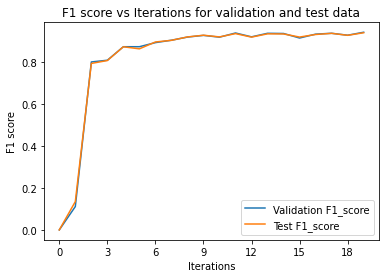

In [ ]:
x=range(0,20)
 
ax = plt.figure().gca()
#...
ax.xaxis.set_major_locator(MaxNLocator(integer=True))
ax.plot(valid_f1scores,label="Validation F1_score")
ax.plot(test_f1scores,label="Test F1_score")
ax.set_xlabel('Iterations')
ax.set_ylabel('F1 score')
ax.legend()
ax.set_title('F1 score vs Iterations for validation and test data')
# naming the x axis 
#ax.xlabel('Iteration') 
# naming the y axis 
#ax.ylabel('F1 score') 
# giving a title to my graph 
#
# show a legend on the plot 
#ax.legend() 
  
# function to show the plot 


Lets define a method to load our saved model

In [ ]:
def load_model(model_path):
    ''' Loads a pre-trained model for prediction on new test sentences
   
    model_path : directory of model saved by spacy.to_disk
    '''
    nlp = spacy.blank('en')
    if 'ner' not in nlp.pipe_names:
        ner = nlp.create_pipe('ner')
        nlp.add_pipe(ner)
    ner = nlp.from_disk(model_path)
    return ner

In [ ]:
len(TEST_DATA)

2154

#### Testing the model and finding predictions;
Since it is assumed this is a hurried approach, the predictions tag I and B but for all words that were not tagged, they are default tagged as O tag.
This just to understand the importance of O tag in the sequence pattern.

In [ ]:
ner = load_model("/content/drive/MyDrive/Colab Notebooks/entity-extraction/hw3/hw3_ner_spacy_GloVE")

predictions = []

test_sentences = [x[0] for x in TEST_DATA] # extract the sentences from [sentence, entity]
for x in test_sentences:
    counter = 1
    this_sentence = x.split()
    doc = ner(x)
    l = {}
    for ent in doc.ents:
        print(ent.text, ent.start_char, ent.end_char, ent.label_)
        l[ent.text] = ent.label_
    for word in this_sentence:
      if word in list(l.keys()):
        predictions.append([counter, word, l[word]])
      else:
        predictions.append([counter, word, 'O'])
      counter +=1
    predictions.append(["\n"])
    print(predictions)
    displacy.render(doc,jupyter=True, style = "ent")
   

luciferase 49 59 B
reporter 60 68 I
gene 69 73 I
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n']]


T 31 32 B
/ 33 34 I
EBP 35 38 I
promoter 39 47 I
- 48 49 I
T 149 150 B
/ 151 152 I
EBP 153 156 I
T 239 240 I
/ 241 242 I
EBP 243 246 I
gene 247 251 I
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 'O'], [32, 'suggested', 'O']

PKC 54 57 B
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 'O'], [32, 'suggested', 'O'], [33, 'that', 'O'], [34, 'autoregulation', 'O'], [35, 'may', 'O'], [36, 'be', 'O'], [37, 'involved', 'O'], [38, 'in', 'O'], [39, 'control

dU2AF38 82 89 B
RS 90 92 I
domain 93 99 I
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 'O'], [32, 'suggested', 'O'], [33, 'that', 'O'], [34, 'autoregulation', 'O'], [35, 'may', 'O'], [36, 'be', 'O'], [37, 'involved', 'O'], 

GST 31 34 B
fusion 35 41 I
proteins 42 50 I
yAP180A 104 111 B
Pan1p 116 121 B
clathrin 126 134 B
proteins 144 152 I
Pan1p 157 162 B
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 'O'], [32, 'suggested', 'O'], [33, 'that', 'O'

ZO 98 100 B
- 101 102 I
1 103 104 I
ZO 159 161 B
- 162 163 I
2 164 165 I
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 'O'], [32, 'suggested', 'O'], [33, 'that', 'O'], [34, 'autoregulation', 'O'], [35, 'may', 'O'], [36, 'be'

Cytochrome 0 10 B
b 11 12 I
human 16 21 B
complex 22 29 I
II 30 32 I
succinate 35 44 B
- 45 46 I
ubiquinone 47 57 I
oxidoreductase 58 72 I
SDHD 203 207 B
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 'O'], [32, 'suggested', 

Paf 18 21 B
hly 101 104 B
PrfA 140 144 B
PrfA 193 197 B
PrfA 252 256 B
- 257 258 I
Paf 259 262 I
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 'O'], [32, 'suggested', 'O'], [33, 'that', 'O'], [34, 'autoregulation', 'O'], [35

Staf 41 45 B
Staf 78 82 B
selenocysteine 93 107 B
tRNA 108 112 I
gene 113 117 I
transcription 118 131 I
activating 132 142 I
factor 143 149 I
Xenopus 153 160 B
laevis 161 167 I
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', '

ROCK 0 4 B
- 5 6 I
I 7 8 I
Kinectin 11 19 B
RhoA 69 73 B
Cdc42 78 83 B
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 'O'], [32, 'suggested', 'O'], [33, 'that', 'O'], [34, 'autoregulation', 'O'], [35, 'may', 'O'], [36, 'be', 

beta 27 31 B
isoform 32 39 I
PtdIns 76 82 B
4 85 86 I
P 89 90 B
kinase 91 97 I
gamma 115 120 B
isoform 121 128 I
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 'O'], [32, 'suggested', 'O'], [33, 'that', 'O'], [34, 'autoregula

beta 4 8 B
heterotrimeric 24 38 B
G 39 40 I
proteins 41 49 I
WD 199 201 B
Trp 204 207 B
- 208 209 I
Asp 210 213 I
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 'O'], [32, 'suggested', 'O'], [33, 'that', 'O'], [34, 'autoregul

LNX 29 32 B
LNX 114 117 B
LNX 133 136 B
- 137 138 I
b 139 140 I
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 'O'], [32, 'suggested', 'O'], [33, 'that', 'O'], [34, 'autoregulation', 'O'], [35, 'may', 'O'], [36, 'be', 'O'], [

cyclooxygenase 74 88 B
product 89 96 I
TF 143 145 B
EGF 150 153 B
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 'O'], [32, 'suggested', 'O'], [33, 'that', 'O'], [34, 'autoregulation', 'O'], [35, 'may', 'O'], [36, 'be', 'O'],

myosin 44 50 B
V 51 52 I
actin 72 77 B
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 'O'], [32, 'suggested', 'O'], [33, 'that', 'O'], [34, 'autoregulation', 'O'], [35, 'may', 'O'], [36, 'be', 'O'], [37, 'involved', 'O'], [38

transcriptase 95 108 B
- 109 110 I
polymerase 111 121 I
chain 122 127 I
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 'O'], [32, 'suggested', 'O'], [33, 'that', 'O'], [34, 'autoregulation', 'O'], [35, 'may', 'O'], [36, 'be',

androgen 25 33 B
regulatory 34 44 I
sequences 45 54 I
rat 97 100 B
androgen 101 109 I
- 110 111 I
binding 112 119 I
protein 120 127 I
gene 128 132 I
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 'O'], [32, 'suggested', 'O'],

cvaA 55 59 B
cvi 114 117 B
colicin 133 140 B
V 141 142 I
immunity 143 151 I
protein 152 159 I
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 'O'], [32, 'suggested', 'O'], [33, 'that', 'O'], [34, 'autoregulation', 'O'], [35, '

gntR 5 9 B
gntT 60 64 B
lacZ 68 72 B
GntR 128 132 B
gntT 162 166 B
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 'O'], [32, 'suggested', 'O'], [33, 'that', 'O'], [34, 'autoregulation', 'O'], [35, 'may', 'O'], [36, 'be', 'O']

gcv 71 74 B
lacZ 77 81 B
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 'O'], [32, 'suggested', 'O'], [33, 'that', 'O'], [34, 'autoregulation', 'O'], [35, 'may', 'O'], [36, 'be', 'O'], [37, 'involved', 'O'], [38, 'in', 'O'], 

PEA3 17 21 B
STAT 26 30 B
v 72 73 B
- 74 75 I
src 76 79 I
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 'O'], [32, 'suggested', 'O'], [33, 'that', 'O'], [34, 'autoregulation', 'O'], [35, 'may', 'O'], [36, 'be', 'O'], [37, 'i

BRCA1 0 5 B
protein 6 13 I
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 'O'], [32, 'suggested', 'O'], [33, 'that', 'O'], [34, 'autoregulation', 'O'], [35, 'may', 'O'], [36, 'be', 'O'], [37, 'involved', 'O'], [38, 'in', 'O']

tRNAPhe 64 71 B
tRNAPro 76 83 B
genes 84 89 I
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 'O'], [32, 'suggested', 'O'], [33, 'that', 'O'], [34, 'autoregulation', 'O'], [35, 'may', 'O'], [36, 'be', 'O'], [37, 'involved', 'O

Ras 57 60 B
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 'O'], [32, 'suggested', 'O'], [33, 'that', 'O'], [34, 'autoregulation', 'O'], [35, 'may', 'O'], [36, 'be', 'O'], [37, 'involved', 'O'], [38, 'in', 'O'], [39, 'control

[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 'O'], [32, 'suggested', 'O'], [33, 'that', 'O'], [34, 'autoregulation', 'O'], [35, 'may', 'O'], [36, 'be', 'O'], [37, 'involved', 'O'], [38, 'in', 'O'], [39, 'controlling', 'O'],

/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


DnaA 29 33 B
RNA 66 69 B
polymerase 70 80 I
pR 106 108 B
promoter 109 117 I
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 'O'], [32, 'suggested', 'O'], [33, 'that', 'O'], [34, 'autoregulation', 'O'], [35, 'may', 'O'], [36, '

Bcl 14 17 B
- 18 19 I
XL 20 22 I
Apaf 52 56 B
- 57 58 I
1 59 60 I
caspase 66 73 B
- 74 75 I
9 76 77 I
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 'O'], [32, 'suggested', 'O'], [33, 'that', 'O'], [34, 'autoregulation', 'O']

Arp1 113 117 B
All1 174 178 B
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 'O'], [32, 'suggested', 'O'], [33, 'that', 'O'], [34, 'autoregulation', 'O'], [35, 'may', 'O'], [36, 'be', 'O'], [37, 'involved', 'O'], [38, 'in', '

Site 58 62 B
II 63 65 I
cognate 66 73 I
proteins 74 82 I
H4 134 136 B
H4 177 179 I
promoter 180 188 I
CAT 191 194 B
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 'O'], [32, 'suggested', 'O'], [33, 'that', 'O'], [34, 'autoreg

plasma 10 16 B
IgE 17 20 I
IgE 110 113 B
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 'O'], [32, 'suggested', 'O'], [33, 'that', 'O'], [34, 'autoregulation', 'O'], [35, 'may', 'O'], [36, 'be', 'O'], [37, 'involved', 'O'], [

Creatine 0 8 B
kinase 9 15 I
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 'O'], [32, 'suggested', 'O'], [33, 'that', 'O'], [34, 'autoregulation', 'O'], [35, 'may', 'O'], [36, 'be', 'O'], [37, 'involved', 'O'], [38, 'in', 'O

NIC 70 73 B
LVEDP 128 133 B
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 'O'], [32, 'suggested', 'O'], [33, 'that', 'O'], [34, 'autoregulation', 'O'], [35, 'may', 'O'], [36, 'be', 'O'], [37, 'involved', 'O'], [38, 'in', 'O'

PR 36 38 B
- 39 40 I
B 41 42 I
NCoR 69 73 B
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 'O'], [32, 'suggested', 'O'], [33, 'that', 'O'], [34, 'autoregulation', 'O'], [35, 'may', 'O'], [36, 'be', 'O'], [37, 'involved', 'O']

PRL 0 3 B
receptor 4 12 I
SHP 28 31 B
- 32 33 I
2 34 35 I
cytosolic 40 49 B
tyrosine 50 58 I
phosphatase 59 70 I
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 'O'], [32, 'suggested', 'O'], [33, 'that', 'O'], [34, 'autoregula

SHP 32 35 B
- 36 37 I
2 38 39 I
Stat5b 150 156 B
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 'O'], [32, 'suggested', 'O'], [33, 'that', 'O'], [34, 'autoregulation', 'O'], [35, 'may', 'O'], [36, 'be', 'O'], [37, 'involved',

[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 'O'], [32, 'suggested', 'O'], [33, 'that', 'O'], [34, 'autoregulation', 'O'], [35, 'may', 'O'], [36, 'be', 'O'], [37, 'involved', 'O'], [38, 'in', 'O'], [39, 'controlling', 'O'],

/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


HMG 45 48 B
- 49 50 I
I 51 52 I
family 53 59 I
SRF 86 89 B
protein 165 172 B
- 173 174 I
protein 175 182 I
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 'O'], [32, 'suggested', 'O'], [33, 'that', 'O'], [34, 'autoregulation',

ATP 0 3 B
MSH2 89 93 B
MSH6 96 100 B
MLH1 105 109 B
PMS1 112 116 B
protein 117 124 I
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 'O'], [32, 'suggested', 'O'], [33, 'that', 'O'], [34, 'autoregulation', 'O'], [35, 'may', 'O'

Phe 34 37 B
insulin 81 88 B
receptor 89 97 I
substrate 98 107 I
1 108 109 I
IRS1 112 116 B
IL 163 165 B
- 166 167 I
4 168 169 I
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 'O'], [32, 'suggested', 'O'], [33, 'that', 'O'], [

kappaB 34 40 B
factor 89 95 I
cAMP 98 102 B
response 103 111 I
element 112 119 I
site 120 124 I
E 164 165 B
- 166 167 I
selectin 168 176 I
gene 177 181 I
TNF 204 207 B
- 208 209 I
alpha 210 215 I
- 216 217 I
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I']

yeast 35 40 B
hnRNP 41 46 I
methyltransferase 47 64 I
HMT1 67 71 B
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 'O'], [32, 'suggested', 'O'], [33, 'that', 'O'], [34, 'autoregulation', 'O'], [35, 'may', 'O'], [36, 'be', 'O']

yeast 35 40 B
hnRNP 41 46 I
methyltransferase 47 64 I
HMT1 67 71 B
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 'O'], [32, 'suggested', 'O'], [33, 'that', 'O'], [34, 'autoregulation', 'O'], [35, 'may', 'O'], [36, 'be', 'O']

Recombinant 0 11 B
HRMT1L2 12 19 I
protein 20 27 I
methyltransferase 78 95 B
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 'O'], [32, 'suggested', 'O'], [33, 'that', 'O'], [34, 'autoregulation', 'O'], [35, 'may', 'O'], [36, 

HRMT1L1 22 29 B
HRMT1L2 34 41 B
human 45 50 B
disease 51 58 I
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 'O'], [32, 'suggested', 'O'], [33, 'that', 'O'], [34, 'autoregulation', 'O'], [35, 'may', 'O'], [36, 'be', 'O'], [37

human 52 57 B
arginine 58 66 I
methyltransferases 67 85 I
HRMT1L1 88 95 B
HRMT1L2 100 107 B
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 'O'], [32, 'suggested', 'O'], [33, 'that', 'O'], [34, 'autoregulation', 'O'], [35, 'ma

PDGF 30 34 B
beta 35 39 I
- 40 41 I
receptor 42 50 I
Crk 73 76 B
proteins 77 85 I
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 'O'], [32, 'suggested', 'O'], [33, 'that', 'O'], [34, 'autoregulation', 'O'], [35, 'may', 'O'], 

E 62 63 B
- 64 65 I
cadherin 66 74 I
E 106 107 B
- 108 109 I
cadherin 110 118 I
extracellular 119 132 I
desmoglein 148 158 B
1 159 160 I
intracellular 161 174 I
E 258 259 B
- 260 261 I
cadherin 262 270 I
extracellular 271 284 I
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 

human 114 119 B
IL 120 122 I
- 123 124 I
5Ralpha 125 132 I
gene 133 137 I
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 'O'], [32, 'suggested', 'O'], [33, 'that', 'O'], [34, 'autoregulation', 'O'], [35, 'may', 'O'], [36, 'be

ALT 103 106 B
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 'O'], [32, 'suggested', 'O'], [33, 'that', 'O'], [34, 'autoregulation', 'O'], [35, 'may', 'O'], [36, 'be', 'O'], [37, 'involved', 'O'], [38, 'in', 'O'], [39, 'contr

retinoic 207 215 B
acid 216 220 I
receptor 221 229 I
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 'O'], [32, 'suggested', 'O'], [33, 'that', 'O'], [34, 'autoregulation', 'O'], [35, 'may', 'O'], [36, 'be', 'O'], [37, 'involv

CCR5 92 96 B
gene 97 101 I
promoter 102 110 I
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 'O'], [32, 'suggested', 'O'], [33, 'that', 'O'], [34, 'autoregulation', 'O'], [35, 'may', 'O'], [36, 'be', 'O'], [37, 'involved', 'O

CL 122 124 B
- 125 126 I
17 127 129 I
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 'O'], [32, 'suggested', 'O'], [33, 'that', 'O'], [34, 'autoregulation', 'O'], [35, 'may', 'O'], [36, 'be', 'O'], [37, 'involved', 'O'], [38,

Epo 17 20 B
PI 92 94 B
- 95 96 I
3 97 98 I
kinase 99 105 I
PLC 108 111 B
- 112 113 I
gamma 114 119 I
Ras 122 125 B
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 'O'], [32, 'suggested', 'O'], [33, 'that', 'O'], [34, 'autoregu

tyrosine 67 75 B
kinase 76 82 I
herbimycin 94 104 B
A 105 106 I
PP1 111 114 B
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 'O'], [32, 'suggested', 'O'], [33, 'that', 'O'], [34, 'autoregulation', 'O'], [35, 'may', 'O'], [36,

ZAP 11 14 B
- 15 16 I
70 17 19 I
SLP 32 35 B
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 'O'], [32, 'suggested', 'O'], [33, 'that', 'O'], [34, 'autoregulation', 'O'], [35, 'may', 'O'], [36, 'be', 'O'], [37, 'involved', 'O'

H 10 11 B
/ 12 13 I
ACA 14 17 I
snoRNAs 18 25 I
Gar1p 42 47 B
snoRNAs 87 94 B
rRNA 190 194 I
molecule 195 203 I
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 'O'], [32, 'suggested', 'O'], [33, 'that', 'O'], [34, 'autoregulat

vitamin 12 19 B
D 20 21 I
receptor 22 30 I
VDR 33 36 B
acid 56 60 I
Xalpha 61 67 I
receptor 68 76 I
RXRalpha 79 87 B
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 'O'], [32, 'suggested', 'O'], [33, 'that', 'O'], [34, 'autore

PPARalpha 38 47 B
ligand 48 54 I
8 55 56 I
PPARalpha 130 139 B
activator 154 163 I
RIP 164 167 I
- 168 169 I
140 170 173 I
PPARalpha 207 216 B
repressor 231 240 I
SMRT 241 245 I
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 

tRNA 214 218 B
- 219 220 I
synthetase 221 231 I
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 'O'], [32, 'suggested', 'O'], [33, 'that', 'O'], [34, 'autoregulation', 'O'], [35, 'may', 'O'], [36, 'be', 'O'], [37, 'involved', 

BPV1 87 91 B
E2 94 96 B
protein 97 104 I
HT 117 119 B
- 120 121 I
3 122 123 I
G1 216 218 B
/ 219 220 I
S 221 222 I
phase 223 228 I
growth 229 235 I
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 'O'], [32, 'suggested', 'O'], 

hGli2 25 30 B
alpha 31 36 I
beta 39 43 B
gamma 46 51 B
TRE2S 185 190 B
LTR 200 203 B
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 'O'], [32, 'suggested', 'O'], [33, 'that', 'O'], [34, 'autoregulation', 'O'], [35, 'may', 'O'

actin 12 17 B
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 'O'], [32, 'suggested', 'O'], [33, 'that', 'O'], [34, 'autoregulation', 'O'], [35, 'may', 'O'], [36, 'be', 'O'], [37, 'involved', 'O'], [38, 'in', 'O'], [39, 'contr

cak1At 9 15 B
CAK 51 54 B
mutation 55 63 I
CAK 124 127 I
mutant 128 134 I
cak1At 137 143 B
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 'O'], [32, 'suggested', 'O'], [33, 'that', 'O'], [34, 'autoregulation', 'O'], [35, 'may

sum1 64 68 B
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 'O'], [32, 'suggested', 'O'], [33, 'that', 'O'], [34, 'autoregulation', 'O'], [35, 'may', 'O'], [36, 'be', 'O'], [37, 'involved', 'O'], [38, 'in', 'O'], [39, 'contro

Ime1 0 4 B
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 'O'], [32, 'suggested', 'O'], [33, 'that', 'O'], [34, 'autoregulation', 'O'], [35, 'may', 'O'], [36, 'be', 'O'], [37, 'involved', 'O'], [38, 'in', 'O'], [39, 'controll

BALB 20 24 B
c 27 28 B
SIV 66 69 I
recombinants 70 82 I
SIV 127 130 B
gene 131 135 I
HIV1 238 242 B
Nef 243 246 I
peptide 247 254 I
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 'O'], [32, 'suggested', 'O'], [33, 'that', 'O'

IRF 26 29 B
- 30 31 I
2 32 33 I
helix 103 108 I
family 109 115 I
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 'O'], [32, 'suggested', 'O'], [33, 'that', 'O'], [34, 'autoregulation', 'O'], [35, 'may', 'O'], [36, 'be', 'O'], 

receptor 14 22 B
/ 23 24 I
G 25 26 I
protein 27 34 I
M2Ach 158 163 B
- 164 165 I
muscarinic 166 176 I
alpha2A 181 188 B
- 189 190 I
adrenergic 191 201 I
receptors 202 211 I
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 'O'],

rat 61 64 B
GnRH 65 69 I
- 70 71 I
R 72 73 I
receptor 89 97 B
G 98 99 I
GGH 162 165 B
Gs 259 261 B
protein 262 269 I
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 'O'], [32, 'suggested', 'O'], [33, 'that', 'O'], [34, 'autore

alpha2 20 26 B
- 27 28 I
antiplasmin 29 40 I
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 'O'], [32, 'suggested', 'O'], [33, 'that', 'O'], [34, 'autoregulation', 'O'], [35, 'may', 'O'], [36, 'be', 'O'], [37, 'involved', 'O'

topoisomerase 37 50 B
I 51 52 I
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 'O'], [32, 'suggested', 'O'], [33, 'that', 'O'], [34, 'autoregulation', 'O'], [35, 'may', 'O'], [36, 'be', 'O'], [37, 'involved', 'O'], [38, 'in',

[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 'O'], [32, 'suggested', 'O'], [33, 'that', 'O'], [34, 'autoregulation', 'O'], [35, 'may', 'O'], [36, 'be', 'O'], [37, 'involved', 'O'], [38, 'in', 'O'], [39, 'controlling', 'O'],

/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


repY 62 66 B
rCGCC 92 97 B
- 98 99 I
3 100 101 I
repZ 121 125 B
ribosome 126 134 I
- 135 136 I
binding 137 144 I
site 145 149 I
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 'O'], [32, 'suggested', 'O'], [33, 'that', 'O'], [

fus3 3 7 B
mutants 8 15 I
Ty1 32 35 B
RNA 36 39 I
FUS3 127 131 B
strains 132 139 I
TyA 169 172 B
integrase 175 184 B
reverse 191 198 B
transcriptase 199 212 I
proteins 213 221 I
Ty1 226 229 B
cDNA 230 234 I
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'],

Ty1 32 35 B
mitogen 58 65 B
- 66 67 I
activated 68 77 I
protein 78 85 I
kinase 86 92 I
Fus3 93 97 I
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 'O'], [32, 'suggested', 'O'], [33, 'that', 'O'], [34, 'autoregulation', 'O'], 

transcription 12 25 B
factor 26 32 I
IIA 33 36 I
TFIIA 39 44 B
protein 79 86 I
TBP 89 92 B
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 'O'], [32, 'suggested', 'O'], [33, 'that', 'O'], [34, 'autoregulation', 'O'], [35, 'may

Pho2 38 42 B
Pho4 95 99 B
Pho2 114 118 B
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 'O'], [32, 'suggested', 'O'], [33, 'that', 'O'], [34, 'autoregulation', 'O'], [35, 'may', 'O'], [36, 'be', 'O'], [37, 'involved', 'O'], [

Ser 20 23 B
- 24 25 I
Thr 26 29 I
Asp 60 63 B
IRF 106 109 B
- 110 111 I
3 112 113 I
PRDI 181 185 B
- 186 187 I
PRDIII 188 194 I
ISRE 198 202 B
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 'O'], [32, 'suggested', 'O'], [33, 

protein 44 51 B
- 52 53 I
protein 54 61 I
ETS 133 136 B
- 137 138 I
domain 139 145 I
proteins 146 154 I
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 'O'], [32, 'suggested', 'O'], [33, 'that', 'O'], [34, 'autoregulation', 'O

YAC 30 33 B
contig 34 40 I
resistance 80 90 I
gene 91 95 I
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 'O'], [32, 'suggested', 'O'], [33, 'that', 'O'], [34, 'autoregulation', 'O'], [35, 'may', 'O'], [36, 'be', 'O'], [37, '

murine 47 53 B
gene 54 58 I
encoding 59 67 I
M 68 69 I
- 70 71 I
protein 72 79 I
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 'O'], [32, 'suggested', 'O'], [33, 'that', 'O'], [34, 'autoregulation', 'O'], [35, 'may', 'O'], [

SD 9 11 B
serum 12 17 I
VEGF 18 22 I
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 'O'], [32, 'suggested', 'O'], [33, 'that', 'O'], [34, 'autoregulation', 'O'], [35, 'may', 'O'], [36, 'be', 'O'], [37, 'involved', 'O'], [38, 

p53 60 63 B
gene 64 68 I
p53 84 87 B
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 'O'], [32, 'suggested', 'O'], [33, 'that', 'O'], [34, 'autoregulation', 'O'], [35, 'may', 'O'], [36, 'be', 'O'], [37, 'involved', 'O'], [38, 

ORF5 14 18 B
agrB 46 50 I
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 'O'], [32, 'suggested', 'O'], [33, 'that', 'O'], [34, 'autoregulation', 'O'], [35, 'may', 'O'], [36, 'be', 'O'], [37, 'involved', 'O'], [38, 'in', 'O'],

hSIE 23 27 B
Stat 32 36 B
- 37 38 I
3 39 40 I
MHC 47 50 B
- 51 52 I
I 53 54 I
Stat 107 111 B
- 112 113 I
3 114 115 I
hSIE 156 160 B
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 'O'], [32, 'suggested', 'O'], [33, 'that', 'O'

LysR 39 43 B
- 44 45 I
type 46 50 I
regulator 51 60 I
CatR 61 65 B
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 'O'], [32, 'suggested', 'O'], [33, 'that', 'O'], [34, 'autoregulation', 'O'], [35, 'may', 'O'], [36, 'be', 'O']

human 135 140 B
RIL 141 144 I
gene 145 149 I
IRF1 180 184 B
gene 185 189 I
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 'O'], [32, 'suggested', 'O'], [33, 'that', 'O'], [34, 'autoregulation', 'O'], [35, 'may', 'O'], [36, 'b

U73 0 3 B
contains 4 12 I
C 13 14 I
28S 88 91 B
ribosomal 92 101 I
RNA 102 105 I
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 'O'], [32, 'suggested', 'O'], [33, 'that', 'O'], [34, 'autoregulation', 'O'], [35, 'may', 'O'], [

ZAP 20 23 B
- 24 25 I
SRC 94 97 B
- 98 99 I
family 100 106 I
kinases 107 114 I
phosphorylate 151 164 B
immunoreceptor 165 179 I
tyrosine 180 188 I
TCR 222 225 B
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 'O'], [32, 'sugge

NF 21 23 B
- 24 25 I
kappaB 26 32 I
ER 68 70 B
calcium 71 78 I
sAPPalpha 125 134 B
kappaB 200 206 B
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 'O'], [32, 'suggested', 'O'], [33, 'that', 'O'], [34, 'autoregulation', 'O'], 

cytokine 5 13 B
receptors 14 23 I
protein 37 44 I
tyrosine 45 53 I
kinases 54 61 I
Jaks 64 68 B
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 'O'], [32, 'suggested', 'O'], [33, 'that', 'O'], [34, 'autoregulation', 'O'], [35,

R618 18 22 B
K 22 23 I
mutation 24 32 I
Stat5 40 45 B
SH2 46 49 I
domain 50 56 I
Stat5 137 142 B
hyperphosphorylation 143 163 I
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 'O'], [32, 'suggested', 'O'], [33, 'that', 'O'], [

nitric 14 20 B
oxide 21 26 I
synthase 27 35 I
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 'O'], [32, 'suggested', 'O'], [33, 'that', 'O'], [34, 'autoregulation', 'O'], [35, 'may', 'O'], [36, 'be', 'O'], [37, 'involved', 'O

HMR 32 35 B
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 'O'], [32, 'suggested', 'O'], [33, 'that', 'O'], [34, 'autoregulation', 'O'], [35, 'may', 'O'], [36, 'be', 'O'], [37, 'involved', 'O'], [38, 'in', 'O'], [39, 'control

collagen 75 83 B
type 84 88 I
IV 89 91 I
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 'O'], [32, 'suggested', 'O'], [33, 'that', 'O'], [34, 'autoregulation', 'O'], [35, 'may', 'O'], [36, 'be', 'O'], [37, 'involved', 'O'], [

protein 45 52 B
Z 53 54 I
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 'O'], [32, 'suggested', 'O'], [33, 'that', 'O'], [34, 'autoregulation', 'O'], [35, 'may', 'O'], [36, 'be', 'O'], [37, 'involved', 'O'], [38, 'in', 'O'],

CD34 71 75 B
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 'O'], [32, 'suggested', 'O'], [33, 'that', 'O'], [34, 'autoregulation', 'O'], [35, 'may', 'O'], [36, 'be', 'O'], [37, 'involved', 'O'], [38, 'in', 'O'], [39, 'contro

UDP 0 3 B
- 4 5 I
GlcNAc 6 12 I
alpha 15 20 B
- 21 22 I
6 23 24 I
- 25 26 I
D 27 28 I
- 29 30 I
mannoside 31 40 I
beta 41 45 I
- 46 47 I
1 48 49 I
N 56 57 I
- 58 59 I
acetylglucosaminyltransferase 60 89 I
II 90 92 I
GnT 95 98 B
II 99 101 I
EC 104 106 B
2 107 108 I
. 109 110 I
4 111 112 I
Asn 173 176 B
- 177 178 I
linked 179 185 I
glycans 186 193 I
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [

cytoplasmic 63 74 B
dynein 75 81 I
heavy 82 87 I
chain 88 93 I
Neurospora 97 107 B
crassa 108 114 I
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 'O'], [32, 'suggested', 'O'], [33, 'that', 'O'], [34, 'autoregulation', 'O'], 

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Rb 17 19 B
protein 20 27 I
D 56 57 B
- 58 59 I
type 60 64 I
cyclins 65 72 I
E2F 132 135 B
transcription 136 149 I
factors 150 157 I
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 'O'], [32, 'suggested', 'O'], [33, 'that', 'O'

TCR 55 58 B
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 'O'], [32, 'suggested', 'O'], [33, 'that', 'O'], [34, 'autoregulation', 'O'], [35, 'may', 'O'], [36, 'be', 'O'], [37, 'involved', 'O'], [38, 'in', 'O'], [39, 'control

luteal 39 45 B
HSP 46 49 I
- 50 51 I
27 52 54 I
PKC 106 109 B
- 110 111 I
delta 112 117 I
PKC 164 167 B
family 168 174 I
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 'O'], [32, 'suggested', 'O'], [33, 'that', 'O'], [34, 'au

lac 171 174 B
operon 175 181 I
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 'O'], [32, 'suggested', 'O'], [33, 'that', 'O'], [34, 'autoregulation', 'O'], [35, 'may', 'O'], [36, 'be', 'O'], [37, 'involved', 'O'], [38, 'in', 

chloramphenicol 165 180 B
acetyltransferase 181 198 I
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 'O'], [32, 'suggested', 'O'], [33, 'that', 'O'], [34, 'autoregulation', 'O'], [35, 'may', 'O'], [36, 'be', 'O'], [37, 'invol

CRP 76 79 B
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 'O'], [32, 'suggested', 'O'], [33, 'that', 'O'], [34, 'autoregulation', 'O'], [35, 'may', 'O'], [36, 'be', 'O'], [37, 'involved', 'O'], [38, 'in', 'O'], [39, 'control

vascular 86 94 B
alpha2 95 101 I
- 102 103 I
adrenoceptors 104 117 I
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 'O'], [32, 'suggested', 'O'], [33, 'that', 'O'], [34, 'autoregulation', 'O'], [35, 'may', 'O'], [36, 'be', 'O

Cbl 19 22 B
family 23 29 I
c 67 68 B
- 69 70 I
Cbl 71 74 I
Cbl 79 82 B
- 83 84 I
b 85 86 I
Sli 111 114 B
- 115 116 I
1 117 118 I
D 145 146 B
- 147 148 I
Cbl 149 152 I
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 'O'], [32, 

Anti 0 4 B
- 5 6 I
PTB 7 10 I
antibodies 11 21 I
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 'O'], [32, 'suggested', 'O'], [33, 'that', 'O'], [34, 'autoregulation', 'O'], [35, 'may', 'O'], [36, 'be', 'O'], [37, 'involved',

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



p82 8 11 B
ERK2 40 44 B
p70 66 69 B
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 'O'], [32, 'suggested', 'O'], [33, 'that', 'O'], [34, 'autoregulation', 'O'], [35, 'may', 'O'], [36, 'be', 'O'], [37, 'involved', 'O'], [38, '

mRNA 10 14 I
splicing 15 23 I
factor 24 30 I
U2AF 31 35 I
U2 38 40 B
small 41 46 I
nuclear 47 54 I
ribonucleoprotein 55 72 I
factor 102 108 I
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 'O'], [32, 'suggested', 'O'], [33, '

serum 58 63 B
ferritin 64 72 I
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 'O'], [32, 'suggested', 'O'], [33, 'that', 'O'], [34, 'autoregulation', 'O'], [35, 'may', 'O'], [36, 'be', 'O'], [37, 'involved', 'O'], [38, 'in', 

myosin 14 20 B
phosphatase 21 32 I
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 'O'], [32, 'suggested', 'O'], [33, 'that', 'O'], [34, 'autoregulation', 'O'], [35, 'may', 'O'], [36, 'be', 'O'], [37, 'involved', 'O'], [38, 'i

VAI 23 26 B
RNA 27 30 I
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 'O'], [32, 'suggested', 'O'], [33, 'that', 'O'], [34, 'autoregulation', 'O'], [35, 'may', 'O'], [36, 'be', 'O'], [37, 'involved', 'O'], [38, 'in', 'O'], [

human 35 40 B
cyclin 41 47 I
- 48 49 I
dependent 50 59 I
kinase 60 66 I
p18 77 80 B
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 'O'], [32, 'suggested', 'O'], [33, 'that', 'O'], [34, 'autoregulation', 'O'], [35, 'may', 'O']

YccA 4 8 B
protein 9 16 I
FtsH 48 52 B
- 53 54 I
YccA11 107 113 B
mutant 114 120 I
protein 121 128 I
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 'O'], [32, 'suggested', 'O'], [33, 'that', 'O'], [34, 'autoregulation', 'O'],

activator 24 33 B
proteins 34 42 I
RNA 82 85 B
polymerase 86 96 I
RNAP 99 103 B
RNAP 165 169 B
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 'O'], [32, 'suggested', 'O'], [33, 'that', 'O'], [34, 'autoregulation', 'O'], [35, 

L1 21 23 B
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 'O'], [32, 'suggested', 'O'], [33, 'that', 'O'], [34, 'autoregulation', 'O'], [35, 'may', 'O'], [36, 'be', 'O'], [37, 'involved', 'O'], [38, 'in', 'O'], [39, 'controll

leukocyte 59 68 B
alkaline 69 77 I
phosphatase 78 89 I


IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Osteoadherin 0 12 B
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 'O'], [32, 'suggested', 'O'], [33, 'that', 'O'], [34, 'autoregulation', 'O'], [35, 'may', 'O'], [36, 'be', 'O'], [37, 'involved', 'O'], [38, 'in', 'O'], [39, 

intron 4 10 B
8 11 12 I
enhancer 13 21 I
GATA 50 54 B
- 55 56 I
1 57 58 I
Sp1 73 76 B
Sp1 165 168 B
protein 169 176 I
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 'O'], [32, 'suggested', 'O'], [33, 'that', 'O'], [34, 'autor

Fak 16 19 B
caspases 23 31 B
anti 121 125 B
Fak 150 153 B
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 'O'], [32, 'suggested', 'O'], [33, 'that', 'O'], [34, 'autoregulation', 'O'], [35, 'may', 'O'], [36, 'be', 'O'], [37, 'i

sigmaA 64 70 B
- 71 72 I
dependent 73 82 I
promoter 83 91 I
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 'O'], [32, 'suggested', 'O'], [33, 'that', 'O'], [34, 'autoregulation', 'O'], [35, 'may', 'O'], [36, 'be', 'O'], [37, 

2Fe 21 24 B
- 25 26 I
2S 27 29 I
ferredoxins 45 56 I
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 'O'], [32, 'suggested', 'O'], [33, 'that', 'O'], [34, 'autoregulation', 'O'], [35, 'may', 'O'], [36, 'be', 'O'], [37, 'involv

Dsg 16 19 B
- 20 21 I
plakoglobin 22 33 I
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 'O'], [32, 'suggested', 'O'], [33, 'that', 'O'], [34, 'autoregulation', 'O'], [35, 'may', 'O'], [36, 'be', 'O'], [37, 'involved', 'O'], 

CBF 41 44 B
NF 47 49 B
- 50 51 I
Y 52 53 I
CCAAT 70 75 B
box 76 79 I
nTPH 133 137 B
gene 138 142 I
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 'O'], [32, 'suggested', 'O'], [33, 'that', 'O'], [34, 'autoregulation', 'O'], [

LPS 17 20 B
- 21 22 I
inducible 23 32 I
HIV 33 36 I
- 37 38 I
1 39 40 I
gene 41 45 I
NF 91 93 B
- 94 95 I
kappa 96 101 I
B 102 103 I
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 'O'], [32, 'suggested', 'O'], [33, 'that', 'O

p53 17 20 B
kinase 51 57 I
STAT 60 64 B
p53 209 212 B
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 'O'], [32, 'suggested', 'O'], [33, 'that', 'O'], [34, 'autoregulation', 'O'], [35, 'may', 'O'], [36, 'be', 'O'], [37, 'invol

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



hybrida 42 49 B
gene 50 54 I
jaf13 57 62 B
helix 97 102 I
protein 103 110 I
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 'O'], [32, 'suggested', 'O'], [33, 'that', 'O'], [34, 'autoregulation', 'O'], [35, 'may', 'O'], [36, '

c 10 11 B
- 12 13 I
erbB3 14 19 I
transcripts 20 31 I
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 'O'], [32, 'suggested', 'O'], [33, 'that', 'O'], [34, 'autoregulation', 'O'], [35, 'may', 'O'], [36, 'be', 'O'], [37, 'invol

collagen 297 305 B
I 306 307 I
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 'O'], [32, 'suggested', 'O'], [33, 'that', 'O'], [34, 'autoregulation', 'O'], [35, 'may', 'O'], [36, 'be', 'O'], [37, 'involved', 'O'], [38, 'in', 

calcitonin 12 22 B
human 113 118 B
parathyroid 119 130 I
hormone 131 138 I
- 139 140 I
related 141 148 I
protein 149 156 I
PTHrP 159 164 B
) 165 166 I
gene 167 171 I
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 'O'], [32, '

Pitx2 19 24 B
homeodomain 37 48 B
protein 49 56 I
Pit 59 62 B
- 63 64 I
1 65 66 I
prolactin 119 128 B
promoter 129 137 I
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 'O'], [32, 'suggested', 'O'], [33, 'that', 'O'], [34, 'au

ornithine 42 51 B
transcarbamylase 52 68 I
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 'O'], [32, 'suggested', 'O'], [33, 'that', 'O'], [34, 'autoregulation', 'O'], [35, 'may', 'O'], [36, 'be', 'O'], [37, 'involved', 'O'],

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



nuclear 18 25 B
ribonucleoprotein 26 43 I
C 44 45 I
protein 46 53 I
U1 69 71 B
U2 74 76 B
U6 83 85 B
snRNAs 86 92 I
bZIP 144 148 B
- 149 150 I
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 'O'], [32, 'suggested', 'O'], [33, 

vTF7 77 81 B
- 82 83 I
3 84 85 I
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 'O'], [32, 'suggested', 'O'], [33, 'that', 'O'], [34, 'autoregulation', 'O'], [35, 'may', 'O'], [36, 'be', 'O'], [37, 'involved', 'O'], [38, 'in'

Cux 36 39 B
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 'O'], [32, 'suggested', 'O'], [33, 'that', 'O'], [34, 'autoregulation', 'O'], [35, 'may', 'O'], [36, 'be', 'O'], [37, 'involved', 'O'], [38, 'in', 'O'], [39, 'control

PhLOP1 78 84 B
PhLOP2 89 95 B
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 'O'], [32, 'suggested', 'O'], [33, 'that', 'O'], [34, 'autoregulation', 'O'], [35, 'may', 'O'], [36, 'be', 'O'], [37, 'involved', 'O'], [38, 'in', '

transcriptase 8 21 B
- 22 23 I
polymerase 24 34 I
chain 35 40 I
RT 52 54 B
- 55 56 I
PCR 57 60 I
Metapenaeus 129 140 I
ensis 141 146 I
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 'O'], [32, 'suggested', 'O'], [33, 'that', 

opuE 44 48 B
P 49 50 I
- 51 52 I
1 53 54 I
sigma 57 62 B
A 63 64 I
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 'O'], [32, 'suggested', 'O'], [33, 'that', 'O'], [34, 'autoregulation', 'O'], [35, 'may', 'O'], [36, 'be', 'O']

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



DNase 0 5 B
I 6 7 I
footprinting 8 20 I
hepatocyte 78 88 B
nuclear 89 96 I
factor 97 103 I
- 104 105 I
1 106 107 I
HNF1 110 114 B
CCAAT 124 129 B
/ 130 131 I
enhancer 132 140 I
- 141 142 I
binding 143 150 I
protein 151 158 I
C 161 162 B
/ 163 164 I
EBP 165 168 I
hormone 210 217 I
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'

rat 24 27 B
Std 28 31 I
promoter 32 40 I
HNF1 70 74 B
C 79 80 B
/ 81 82 I
EBP 83 86 I
rat 132 135 B
Std 136 139 I
gene 140 144 I
OCT 224 227 B
- 228 229 I
1 230 231 I
C 236 237 B
/ 238 239 I
EBP 240 243 I
OCT 396 399 B
- 400 401 I
1 402 403 I
C 408 409 B
/ 410 411 I
EBP 412 415 I
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'

Hsk1 9 13 B
phosphorylates 14 28 I
Cdc19 33 38 B
Mcm2 41 45 B
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 'O'], [32, 'suggested', 'O'], [33, 'that', 'O'], [34, 'autoregulation', 'O'], [35, 'may', 'O'], [36, 'be', 'O'], [37

yeast 4 9 B
MMS2 10 14 I
gene 15 19 I
mms2 107 111 B
- 112 113 I
1 114 115 I
mutant 116 122 I
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 'O'], [32, 'suggested', 'O'], [33, 'that', 'O'], [34, 'autoregulation', 'O'], [35, '

E5A 47 50 B
protein 51 58 I
E5 75 77 B
transcript 78 88 I
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 'O'], [32, 'suggested', 'O'], [33, 'that', 'O'], [34, 'autoregulation', 'O'], [35, 'may', 'O'], [36, 'be', 'O'], [37, 'i

G 155 156 B
- 157 158 I
CSF 159 162 I
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 'O'], [32, 'suggested', 'O'], [33, 'that', 'O'], [34, 'autoregulation', 'O'], [35, 'may', 'O'], [36, 'be', 'O'], [37, 'involved', 'O'], [38,

Rho 14 17 B
AP 21 23 B
- 24 25 I
1 26 27 I
mitogen 50 57 B
- 58 59 I
activated 60 69 I
protein 70 77 I
kinase 78 84 I
pathway 85 92 I
MEK 130 133 B
inhibitor 134 143 I
PD98059 146 153 B
Rho 171 174 B
- 175 176 I
AP 185 187 B
- 188 189 I
1 190 191 I


IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



- 25 26 I
2 27 28 I
- 29 30 I
oxo 31 34 I
- 35 36 I
acid 37 41 I
dehydrogenase 42 55 I
BCOD 58 62 B
) 63 64 I
kinase 65 71 I
mRNA 72 76 I
Sp1 166 169 B
binding 170 177 I
sites 178 183 I
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [3

Sp1 25 28 B
Sp1 126 129 B
kinase 149 155 B
basal 156 161 I
promoter 162 170 I
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 'O'], [32, 'suggested', 'O'], [33, 'that', 'O'], [34, 'autoregulation', 'O'], [35, 'may', 'O'], [36,

NF 85 87 B
- 88 89 I
kappaB 90 96 I
AP 101 103 B
- 104 105 I
1 106 107 I
IL 144 146 B
- 147 148 I
8 149 150 I
gene 151 155 I
HTLV 159 163 B
- 164 165 I
I 166 167 I
Tax 168 171 I
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 

human 49 54 B
estrogen 55 63 I
receptor 64 72 I
- 73 74 I
alpha 75 80 I
ERalpha 83 90 B
E2 115 117 B
U2 149 151 B
- 152 153 I
OS 154 156 I
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 'O'], [32, 'suggested', 'O'], [33, 'tha

ERalpha 77 84 B
E2 125 127 B
- 128 129 I


IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



ERKs 9 13 B
IL 24 26 B
- 27 28 I
6 29 30 I
Stat3 45 50 B
type 166 170 I
Stat3 171 176 I
Jak1 207 211 I
Jak2 216 220 B
Stat3 233 238 B
Jak 246 249 B
- 250 251 I
STAT 252 256 I
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 'O'

phosphatidylinositol 14 34 B
Pi 177 179 B
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 'O'], [32, 'suggested', 'O'], [33, 'that', 'O'], [34, 'autoregulation', 'O'], [35, 'may', 'O'], [36, 'be', 'O'], [37, 'involved', 'O'], 

HEFT1 60 65 B
Sp1 129 132 B
Sp3 136 139 B
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 'O'], [32, 'suggested', 'O'], [33, 'that', 'O'], [34, 'autoregulation', 'O'], [35, 'may', 'O'], [36, 'be', 'O'], [37, 'involved', 'O'], 

IgG 76 79 B
antibodies 80 90 I
platelet 119 127 B
factor 128 134 I
4 135 136 I
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 'O'], [32, 'suggested', 'O'], [33, 'that', 'O'], [34, 'autoregulation', 'O'], [35, 'may', 'O'], [36

adhesin 126 133 B
specificity 134 145 I
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 'O'], [32, 'suggested', 'O'], [33, 'that', 'O'], [34, 'autoregulation', 'O'], [35, 'may', 'O'], [36, 'be', 'O'], [37, 'involved', 'O'], [3

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



CONSTANS 26 34 B
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 'O'], [32, 'suggested', 'O'], [33, 'that', 'O'], [34, 'autoregulation', 'O'], [35, 'may', 'O'], [36, 'be', 'O'], [37, 'involved', 'O'], [38, 'in', 'O'], [39, 'co

POU 0 3 B
- 4 5 I
domain 6 12 I
proteins 13 21 I
specific 48 56 I
factor 57 63 I
Pit 64 67 I
- 68 69 I
1 70 71 I
homeodomain 93 104 B
family 105 111 I
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 'O'], [32, 'suggested', 'O'

Wild 0 4 B
- 5 6 I
type 7 11 I
MyoD 23 27 I
E1 64 66 B
E3 69 71 B
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 'O'], [32, 'suggested', 'O'], [33, 'that', 'O'], [34, 'autoregulation', 'O'], [35, 'may', 'O'], [36, 'be', 'O'],

MyoD 82 86 B
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 'O'], [32, 'suggested', 'O'], [33, 'that', 'O'], [34, 'autoregulation', 'O'], [35, 'may', 'O'], [36, 'be', 'O'], [37, 'involved', 'O'], [38, 'in', 'O'], [39, 'contro

Sp1 51 54 B
site 55 59 I
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 'O'], [32, 'suggested', 'O'], [33, 'that', 'O'], [34, 'autoregulation', 'O'], [35, 'may', 'O'], [36, 'be', 'O'], [37, 'involved', 'O'], [38, 'in', 'O'], 

WBC 56 59 B
myeloperoxidase 85 100 B
MPO 112 115 B


IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



glucocorticoid 14 28 B
receptor 29 37 I
Stat5 59 64 B
Stat5 78 83 B
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 'O'], [32, 'suggested', 'O'], [33, 'that', 'O'], [34, 'autoregulation', 'O'], [35, 'may', 'O'], [36, 'be', 'O'

UKLF 35 39 B
Cys2 75 79 B
- 80 81 I
His2 82 86 I
type 87 91 I
beta 137 141 B
- 142 143 I
globin 144 150 I
promoter 151 159 I
Sp1 171 174 B
recognition 175 186 I
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 'O'], [32, 'sugge

mouse 30 35 B
enzyme 36 42 I
gamma 50 55 B
- 56 57 I
glutamyl 58 66 I
leukotrienase 67 80 I
GGL 83 86 B
leukotriene 103 114 B
C4 115 117 I
LTC4 120 124 B
leukotriene 130 141 B
D4 142 144 I
LTD4 147 151 B
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [3

glutathione 79 90 B
peroxidase 91 101 I
- 102 103 I
1 104 105 I


IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



cwg2 4 8 B
- 9 10 I
1 11 12 I
mutation 13 21 I
A202 138 142 B
T 142 143 I
cwg2p 151 156 B
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 'O'], [32, 'suggested', 'O'], [33, 'that', 'O'], [34, 'autoregulation', 'O'], [35, 'may'

ORF5 83 87 B
deltaX 90 96 B
transcript 97 107 I
promoter 108 116 I
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 'O'], [32, 'suggested', 'O'], [33, 'that', 'O'], [34, 'autoregulation', 'O'], [35, 'may', 'O'], [36, 'be', 'O']

MBP 22 25 B
fusions 26 33 I
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 'O'], [32, 'suggested', 'O'], [33, 'that', 'O'], [34, 'autoregulation', 'O'], [35, 'may', 'O'], [36, 'be', 'O'], [37, 'involved', 'O'], [38, 'in', 'O'

myosin 8 14 B
- 15 16 I
binding 17 24 I
protein 25 32 I
C 33 34 I
MyBP 37 41 B
- 42 43 I
C 44 45 I
protein 67 74 B
kinase 75 81 I
A 82 83 I
protein 88 95 B
kinase 96 102 I
C 103 104 I
phosphorylation 105 120 I
sites 121 126 I
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Htra2 0 5 B
- 6 7 I
beta3 8 13 I
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 'O'], [32, 'suggested', 'O'], [33, 'that', 'O'], [34, 'autoregulation', 'O'], [35, 'may', 'O'], [36, 'be', 'O'], [37, 'involved', 'O'], [38, 'in'

Gng3lg 0 6 B
transcripts 7 18 I
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 'O'], [32, 'suggested', 'O'], [33, 'that', 'O'], [34, 'autoregulation', 'O'], [35, 'may', 'O'], [36, 'be', 'O'], [37, 'involved', 'O'], [38, 'in',

Gng3 59 63 B
Gng3lg 68 74 B
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 'O'], [32, 'suggested', 'O'], [33, 'that', 'O'], [34, 'autoregulation', 'O'], [35, 'may', 'O'], [36, 'be', 'O'], [37, 'involved', 'O'], [38, 'in', 'O'

glutathione 49 60 B
S 61 62 I
- 63 64 I
transferase 65 76 I
fusion 77 83 I
protein 84 91 I
human 140 145 B
NRAMP2 146 152 I
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 'O'], [32, 'suggested', 'O'], [33, 'that', 'O'], [34, 

apolipoprotein 18 32 B
B 33 34 I
mRNA 35 39 I
editing 40 47 I
enzyme 48 54 I
- 55 56 I
complex 57 64 I
hnRNP 68 73 B
C1 74 76 I
protein 77 84 I
40S 89 92 B
hnRNP 93 98 I


IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



CBP90 35 40 B
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 'O'], [32, 'suggested', 'O'], [33, 'that', 'O'], [34, 'autoregulation', 'O'], [35, 'may', 'O'], [36, 'be', 'O'], [37, 'involved', 'O'], [38, 'in', 'O'], [39, 'contr

V3 56 58 B
HIV 67 70 B
- 71 72 I
1 73 74 I
gp120 75 80 I
IIIB 81 85 I
LAI 88 91 B
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 'O'], [32, 'suggested', 'O'], [33, 'that', 'O'], [34, 'autoregulation', 'O'], [35, 'may', 'O'], 

aphidicolin 63 74 B
- 75 76 I
sensitive 77 86 I
late 87 91 I
TAAG 118 122 B
aphidicolin 165 176 B
- 177 178 I
ATG 333 336 I
lef2 340 344 B
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 'O'], [32, 'suggested', 'O'], [33, 'tha

human 4 9 B
2 10 11 I
- 39 40 I
5A 41 43 I
synthetases 46 57 I
interferon 82 92 I
IFN 95 98 B
anti 112 116 I
- 117 118 I
viral 119 124 I
proteins 125 133 I


IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



CsA 132 135 B
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 'O'], [32, 'suggested', 'O'], [33, 'that', 'O'], [34, 'autoregulation', 'O'], [35, 'may', 'O'], [36, 'be', 'O'], [37, 'involved', 'O'], [38, 'in', 'O'], [39, 'contr

Hsp90 48 53 B
Cns1 119 123 B
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 'O'], [32, 'suggested', 'O'], [33, 'that', 'O'], [34, 'autoregulation', 'O'], [35, 'may', 'O'], [36, 'be', 'O'], [37, 'involved', 'O'], [38, 'in', 'O

Ras 4 7 B
- 8 9 I
related 10 17 I
GTPases 18 25 I
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 'O'], [32, 'suggested', 'O'], [33, 'that', 'O'], [34, 'autoregulation', 'O'], [35, 'may', 'O'], [36, 'be', 'O'], [37, 'involved'

RNA 101 104 B
polymerases 105 116 I


IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Lu 46 48 B
- 49 50 I
ECAM 51 55 I
- 56 57 I
1 58 59 I
peptides 60 68 I
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 'O'], [32, 'suggested', 'O'], [33, 'that', 'O'], [34, 'autoregulation', 'O'], [35, 'may', 'O'], [36, 'be', 

cAMP 54 58 B
- 59 60 I
dependent 61 70 I
protein 71 78 I
protein 114 121 B
kinase 122 128 I
A 129 130 I
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 'O'], [32, 'suggested', 'O'], [33, 'that', 'O'], [34, 'autoregulation', 'O

BAP2 36 40 B
BAP3 65 69 B
gene 70 74 I
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 'O'], [32, 'suggested', 'O'], [33, 'that', 'O'], [34, 'autoregulation', 'O'], [35, 'may', 'O'], [36, 'be', 'O'], [37, 'involved', 'O'], [38

HMG 36 39 B
I 40 41 I
HLA 77 80 B
- 81 82 I
DRA 83 86 I
gene 87 91 I
Oct 106 109 B
- 110 111 I
2A 112 114 I
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 'O'], [32, 'suggested', 'O'], [33, 'that', 'O'], [34, 'autoregulation'

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Ha 8 10 B
- 11 12 I
Ras 13 16 I
G12V 19 23 B
T35S 26 30 B
Ha 35 37 B
- 38 39 I
RasV12S35 40 49 I
Ha 102 104 B
- 105 106 I
Ras 107 110 I
G12V 113 117 B
E37 120 123 B
G 123 124 I
Ha 129 131 B
- 132 133 I
RasV12G37 134 143 I
RalGDS 168 174 B
pathway 175 182 I
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27

human 25 30 B
cyclin 31 37 I
cyclin 40 46 B
E2 47 49 I
cyclin 90 96 B
E 97 98 I
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 'O'], [32, 'suggested', 'O'], [33, 'that', 'O'], [34, 'autoregulation', 'O'], [35, 'may', 'O'], [3

dopamine 4 12 B
D4 13 15 I
receptor 16 24 I
receptors 65 74 I
SH3 100 103 B
binding 104 111 I


IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



human 4 9 B
SHBG 10 14 I
proximal 15 23 I
promoter 24 32 I
DNase 49 54 B
I 55 56 I
footprinting 57 69 I
FP1 131 134 B
- 135 136 I
FP6 137 140 I
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 'O'], [32, 'suggested', 'O'], [33,

transcripts 74 85 B
C 86 87 I
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 'O'], [32, 'suggested', 'O'], [33, 'that', 'O'], [34, 'autoregulation', 'O'], [35, 'may', 'O'], [36, 'be', 'O'], [37, 'involved', 'O'], [38, 'in', '

Asn 42 45 B
p190 68 72 B
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 'O'], [32, 'suggested', 'O'], [33, 'that', 'O'], [34, 'autoregulation', 'O'], [35, 'may', 'O'], [36, 'be', 'O'], [37, 'involved', 'O'], [38, 'in', 'O'], 

Wild 0 4 B
type 5 9 I
HA 10 12 I
- 13 14 I
p190 15 19 I
Rho 113 116 B


IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



chromatin 79 88 B
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 'O'], [32, 'suggested', 'O'], [33, 'that', 'O'], [34, 'autoregulation', 'O'], [35, 'may', 'O'], [36, 'be', 'O'], [37, 'involved', 'O'], [38, 'in', 'O'], [39, 'c

SKO1 12 16 B
ENA1 37 41 B
hog1 58 62 B
mutant 63 69 I
Sko1p 139 144 B
HOG 177 180 B
pathway 181 188 I
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 'O'], [32, 'suggested', 'O'], [33, 'that', 'O'], [34, 'autoregulation', 'O']

SPP381 59 65 B
prp38 166 171 B
- 172 173 I
1 174 175 I
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 'O'], [32, 'suggested', 'O'], [33, 'that', 'O'], [34, 'autoregulation', 'O'], [35, 'may', 'O'], [36, 'be', 'O'], [37, 'invo

p68 48 51 B


IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Bmp2 23 27 B
Sp1 89 92 B
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 'O'], [32, 'suggested', 'O'], [33, 'that', 'O'], [34, 'autoregulation', 'O'], [35, 'may', 'O'], [36, 'be', 'O'], [37, 'involved', 'O'], [38, 'in', 'O'], 

tubulin 62 69 B
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 'O'], [32, 'suggested', 'O'], [33, 'that', 'O'], [34, 'autoregulation', 'O'], [35, 'may', 'O'], [36, 'be', 'O'], [37, 'involved', 'O'], [38, 'in', 'O'], [39, 'con

MA 26 28 B
protein 29 36 I


IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Pax6 147 151 B
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 'O'], [32, 'suggested', 'O'], [33, 'that', 'O'], [34, 'autoregulation', 'O'], [35, 'may', 'O'], [36, 'be', 'O'], [37, 'involved', 'O'], [38, 'in', 'O'], [39, 'cont

collagen 26 34 B
fibers 35 41 I
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 'O'], [32, 'suggested', 'O'], [33, 'that', 'O'], [34, 'autoregulation', 'O'], [35, 'may', 'O'], [36, 'be', 'O'], [37, 'involved', 'O'], [38, 'in',

attP 31 35 B
attB 38 42 B
attL 77 81 B
attR 86 90 B
integrase 187 196 B
gene 197 201 I
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 'O'], [32, 'suggested', 'O'], [33, 'that', 'O'], [34, 'autoregulation', 'O'], [35, 'may', '

Interferon 0 10 B
- 11 12 I
alpha 13 18 I


IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Glvr 32 36 B
- 37 38 I
1 39 40 I
gene 41 45 I
virus 161 166 I
envelope 167 175 I
proteins 176 184 I
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 'O'], [32, 'suggested', 'O'], [33, 'that', 'O'], [34, 'autoregulation', 'O'], 

mouse 21 26 B
glycolate 27 36 I
oxidase 37 44 I
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 'O'], [32, 'suggested', 'O'], [33, 'that', 'O'], [34, 'autoregulation', 'O'], [35, 'may', 'O'], [36, 'be', 'O'], [37, 'involved', 

PKR 29 32 B
PKR 107 110 B
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 'O'], [32, 'suggested', 'O'], [33, 'that', 'O'], [34, 'autoregulation', 'O'], [35, 'may', 'O'], [36, 'be', 'O'], [37, 'involved', 'O'], [38, 'in', 'O'],

ribosomal 14 23 B
protein 24 31 I
L18 32 35 I
PKR 56 59 B


IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



C3 0 2 B
toxin 3 8 I
RhoA 30 34 B
c 125 126 B
- 127 128 I
Fos 129 132 I
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 'O'], [32, 'suggested', 'O'], [33, 'that', 'O'], [34, 'autoregulation', 'O'], [35, 'may', 'O'], [36, 'be',

C3 10 12 B
toxin 13 18 I
AP 81 83 B
- 84 85 I
1 86 87 I
AP 158 160 B
- 161 162 I
1 163 164 I
Ro 236 238 B
- 239 240 I
31 241 243 I


IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Caenorhabditis 60 74 B
elegans 75 82 I
MAB 83 86 I
- 87 88 I
3 89 90 I
Drosophila 95 105 B
melanogaster 106 118 I
DSX 119 122 I
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 'O'], [32, 'suggested', 'O'], [33, 'that', 'O'], [

p42 12 15 B
JNK 29 32 B
pathway 33 40 I
IL 71 73 B
- 74 75 I
1beta 76 81 I
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 'O'], [32, 'suggested', 'O'], [33, 'that', 'O'], [34, 'autoregulation', 'O'], [35, 'may', 'O'], [36, 'b

viral 54 59 B
coat 60 64 I
protein 65 72 I
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 'O'], [32, 'suggested', 'O'], [33, 'that', 'O'], [34, 'autoregulation', 'O'], [35, 'may', 'O'], [36, 'be', 'O'], [37, 'involved', 'O'],

ZIS 66 69 B
- 70 71 I
2 72 73 I
ZIS 88 91 B
- 92 93 I
1 94 95 I
ZIS 137 140 B
- 141 142 I
1 143 144 I


IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



TbetaRII 66 74 B
TGF 118 121 B
- 122 123 I
beta 124 128 I
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 'O'], [32, 'suggested', 'O'], [33, 'that', 'O'], [34, 'autoregulation', 'O'], [35, 'may', 'O'], [36, 'be', 'O'], [37, 'i

carboxyhemoglobin 28 45 B
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 'O'], [32, 'suggested', 'O'], [33, 'that', 'O'], [34, 'autoregulation', 'O'], [35, 'may', 'O'], [36, 'be', 'O'], [37, 'involved', 'O'], [38, 'in', 'O'],

CHD 19 22 B
IgG 121 124 B
antibodies 125 135 I
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 'O'], [32, 'suggested', 'O'], [33, 'that', 'O'], [34, 'autoregulation', 'O'], [35, 'may', 'O'], [36, 'be', 'O'], [37, 'involved', '

CD4 25 28 B
Nef 102 105 B
W57 133 136 B
L58 141 144 B
AP 164 166 

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Oct 7 10 B
- 11 12 I
1 13 14 I
POU 29 32 B
- 33 34 I
specific 35 43 I
GCAT 64 68 B
half 69 73 I
- 74 75 I
site 76 80 I
Pit 134 137 B
- 138 139 I
1 140 141 I
POU 142 145 I
- 146 147 I
specific 148 156 I
GTAT 166 170 B
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, 

V1a 34 37 B
/ 38 39 I
V2 40 42 I
hybrid 43 49 I
receptors 50 59 I
V1a 109 112 B
receptor 113 121 I
V2 229 231 B
receptor 232 240 I
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 'O'], [32, 'suggested', 'O'], [33, 'that', 'O']

SD 83 85 B
2 86 87 I
. 88 89 I
6 90 91 I
serum 130 135 B
creatine 136 144 I
kinase 145 151 I
CK 154 156 B
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 'O'], [32, 'suggested', 'O'], [33, 'that', 'O'], [34, 'autoregulation', 

GPR34 58 63 B
mRNA 64 68 I
transcripts 69 80 I
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 'O'], [32, 'suggested', 'O'], [33, 'that', 'O'], [34, 'autoregulation', 'O'], [35, 'may', 'O'], [36, 'be', 'O'], [37, 'involved', '

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



unr 12 15 I
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 'O'], [32, 'suggested', 'O'], [33, 'that', 'O'], [34, 'autoregulation', 'O'], [35, 'may', 'O'], [36, 'be', 'O'], [37, 'involved', 'O'], [38, 'in', 'O'], [39, 'control

ZF5 75 78 B
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 'O'], [32, 'suggested', 'O'], [33, 'that', 'O'], [34, 'autoregulation', 'O'], [35, 'may', 'O'], [36, 'be', 'O'], [37, 'involved', 'O'], [38, 'in', 'O'], [39, 'control

Channel 47 54 I
isoforms 55 63 I
1 64 65 I


IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



HS2 54 57 B
HS3 60 63 B
human 118 123 B
globin 124 130 I
gene 131 135 I
DNase 229 234 B
I 235 236 I
hypersensitive 237 251 I
holocomplex 252 263 I
globin 315 321 B
gene 322 326 I
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',',

[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 'O'], [32, 'suggested', 'O'], [33, 'that', 'O'], [34, 'autoregulation', 'O'], [35, 'may', 'O'], [36, 'be', 'O'], [37, 'involved', 'O'], [38, 'in', 'O'], [39, 'controlling', 'O'],

/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


EPO 44 47 B
serum 106 111 B
ferritin 112 120 I
transferrin 125 136 B
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 'O'], [32, 'suggested', 'O'], [33, 'that', 'O'], [34, 'autoregulation', 'O'], [35, 'may', 'O'], [36, 'be', 'O

p33 32 35 B
subunit 36 43 I
eIF3 47 51 B
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 'O'], [32, 'suggested', 'O'], [33, 'that', 'O'], [34, 'autoregulation', 'O'], [35, 'may', 'O'], [36, 'be', 'O'], [37, 'involved', 'O'], [

ATF 28 31 B
- 32 33 I
2 34 35 I
TGF 60 63 B
- 64 65 I
beta 66 70 I
Smad 126 130 B
TAK1 135 139 B


IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



repressor 53 62 B
proteins 63 71 I
BP1 72 75 I
BP2 80 83 B
beta 115 119 B
globin 120 126 I
gene 127 131 I
flanking 132 140 I
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 'O'], [32, 'suggested', 'O'], [33, 'that', 'O'], [34,

AP 27 29 B
- 30 31 I
2alpha 32 38 I
AP 43 45 B
- 46 47 I
2beta 48 53 I
R 101 102 B
- 103 104 I
FABP 105 109 I
promoter 110 118 I
AP 131 133 B
- 134 135 I
2 136 137 I
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 'O'], [32, '

apoB 46 50 B


IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



insulin 32 39 B
IRI 42 45 B
C 49 50 B
- 51 52 I
peptide 53 60 I
glucagon 63 71 B
GLP 78 81 B
- 82 83 I
1 84 85 I
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 'O'], [32, 'suggested', 'O'], [33, 'that', 'O'], [34, 'autoregula

recombinant 5 16 B
product 17 24 I
Staphylococcal 65 79 B
protein 80 87 I
A 88 89 I
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 'O'], [32, 'suggested', 'O'], [33, 'that', 'O'], [34, 'autoregulation', 'O'], [35, 'may', 'O']

anti 85 89 B
- 90 91 I
Z 92 93 I
- 94 95 I
DNA 96 99 I
Ab 100 102 I
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 'O'], [32, 'suggested', 'O'], [33, 'that', 'O'], [34, 'autoregulation', 'O'], [35, 'may', 'O'], [36, 'be', 'O'

PSU1 55 59 B
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 'O'], [32, 'suggested', 'O'], [33, 'that', 'O'], [34, 'autoregulation', 'O'], [35, 'may', 'O'], [36, 'be', 'O'], [37, 'involved', 'O'], [38, 'in', 'O'], [39, 'contro

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



MEF 0 3 B
AML1B 8 13 B
interleukin 48 59 B
3 60 61 I
promoter 62 70 I
reporter 71 79 I
gene 80 84 I
MEF 128 131 B
MEF 151 154 B
AML1 176 180 B
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 'O'], [32, 'suggested', 'O'], [33, 

GRR 38 41 B
p50 81 84 B
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 'O'], [32, 'suggested', 'O'], [33, 'that', 'O'], [34, 'autoregulation', 'O'], [35, 'may', 'O'], [36, 'be', 'O'], [37, 'involved', 'O'], [38, 'in', 'O'], [

p21 44 47 B


IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



PH 26 28 B
Akt 39 42 B
PKB 45 48 B
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 'O'], [32, 'suggested', 'O'], [33, 'that', 'O'], [34, 'autoregulation', 'O'], [35, 'may', 'O'], [36, 'be', 'O'], [37, 'involved', 'O'], [38, 'i

CINC 17 21 B
promoter 22 30 I
IL 34 36 B
- 37 38 I
17 39 41 I
IEC 45 48 B
- 49 50 I
6 51 52 I
TNF 63 66 B
receptor 67 75 I
- 76 77 I
associated 78 88 I
factor 89 95 I
- 96 97 I
6 98 99 I
TRAF6 102 107 B
TRAF2 119 124 B
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29

SCFFWD1 0 7 B
beta 84 88 B
- 89 90 I
catenin 91 98 I
protein 99 106 I
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 'O'], [32, 'suggested', 'O'], [33, 'that', 'O'], [34, 'autoregulation', 'O'], [35, 'may', 'O'], [36, 'be', '

Bub2p 2 7 B
- 8 9 I
dependent 10 19 I
spindle 20 27 I
checkpoint 28 38 I
Dbf2p 61 66 B
kinase 67 73 I


IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



SNV 53 56 B
Rex 110 113 B
Rex 116 119 B
- 120 121 I
responsive 122 132 I
SNV 228 231 B
RNA 232 235 I
Rex 297 300 B
- 301 302 I
like 303 307 I
proteins 308 316 I
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 'O'], [32, 'sugge

ubiquitin 33 42 B
- 43 44 I
APC 87 90 B
- 91 92 I
dependent 93 102 I
Clb 150 153 B
cyclin 156 162 B
subunit 163 170 I
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 'O'], [32, 'suggested', 'O'], [33, 'that', 'O'], [34, 'autor

mitogen 15 22 B
activated 23 32 I
protein 33 40 I
MAP 43 46 B
) 47 48 I
kinase 49 55 I
family 56 62 I
kinase 98 104 I
protein 126 133 I
kinase 134 140 I
- 141 142 I
1 143 144 I
c 147 148 B
- 149 150 I
Jun 151 154 I
NH2 155 158 I
- 159 160 I
terminal 161 169 I
kinase 170 176 I
p38 183 186 B
growth 249 255 B
factors 256 263 I


IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



RanQ69L 4 11 B
CRM1 51 55 B
NPC 115 118 B
p62 145 148 B
complex 149 156 I
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 'O'], [32, 'suggested', 'O'], [33, 'that', 'O'], [34, 'autoregulation', 'O'], [35, 'may', 'O'], [36, 'be

ART5 67 71 B
[[1, 'The', 'O'], [2, 'genomic', 'O'], [3, 'fragments', 'O'], [4, 'were', 'O'], [5, 'fused', 'O'], [6, 'upstream', 'O'], [7, 'of', 'O'], [8, 'the', 'O'], [9, 'luciferase', 'B'], [10, 'reporter', 'I'], [11, 'gene', 'I'], [12, '.', 'O'], ['\n'], [1, 'Cotransfection', 'O'], [2, 'analyses', 'O'], [3, 'of', 'O'], [4, 'the', 'O'], [5, 'T', 'I'], [6, '/', 'I'], [7, 'EBP', 'I'], [8, 'promoter', 'I'], [9, '-', 'I'], [10, 'reporter', 'O'], [11, 'constructs', 'O'], [12, 'with', 'O'], [13, 'a', 'O'], [14, 'T', 'I'], [15, '/', 'I'], [16, 'EBP', 'I'], [17, 'expression', 'O'], [18, 'vector', 'O'], [19, 'into', 'O'], [20, 'human', 'O'], [21, 'HepG2', 'O'], [22, 'cells', 'O'], [23, ',', 'O'], [24, 'which', 'O'], [25, 'do', 'O'], [26, 'not', 'O'], [27, 'express', 'O'], [28, 'T', 'I'], [29, '/', 'I'], [30, 'EBP', 'I'], [31, ',', 'O'], [32, 'suggested', 'O'], [33, 'that', 'O'], [34, 'autoregulation', 'O'], [35, 'may', 'O'], [36, 'be', 'O'], [37, 'involved', 'O'], [38, 'in', 'O'], [39, 'contro

In [ ]:
 import pandas as pd
 df = pd.DataFrame.from_records(predictions)
 df.head()

In [ ]:
df.to_csv('predictions_ib.csv', sep="\t", header=False, index = False)

In [ ]:
len(predictions), counter

(68880, 32)

In [ ]:
ner = load_model("/content/drive/MyDrive/Colab Notebooks/entity-extraction/hw3/hw3_ner_spacy_GloVE")
doc = ner("Selegiline - induced postural hypotension in Parkinson ' s disease : a longitudinal study on the effects of drug withdrawal.The aims of this study were to confirm our previous findings in a separate cohort of patients and to determine the time course of the cardiovascular consequences of stopping selegiline in the expectation that this might shed light on the mechanisms by which the drug causes orthostatic hypotension")
displacy.render(doc,jupyter=True, style = "ent")

/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)
